# Homework: Texture Synthesis and Hole Filling

### In this homework we will implement the algorithm originated from the paper "Texture Synthesis by Non-Parametric Sampling"

### The formulation of the problem.

Let we have an image $I\in\mathbb{R}^{H\times W\times 3}$ and a binary mask $M\in \{0,1\}^{H\times W}$. Suppose the pixels of $I$ which are marked by $1$ in the binary mask $M$ are unknown, i.e. we do not know the values $I_{ij}$ for every $i,j$ shuch that $M_{ij} = 1$ (and also we know all the values $I_{ij}$ for every $i,j$ such that $M_{ij}=0$).

The problem is $\textbf{to estimate the unknown values of}$ $I$.

## The algorithm

##### As you know the idea of the algorithm is to "fill the hole" in the image $I$ starting from its boundary points and iteratively fill until no unknown pixels of $I$ remain. So let's describe one iteration of this filling process, i.e. how we fill the boundary of the "hole" which is described by the image $M$ (the set of pixels (i,j), for which $M_{ij} = 1$, we call a "hole").

At first we need to understand what is the "boundary" of the "hole". This is the set of pixels $(i,j)$ for which $M_{ij} = 1$, but at least for one neighbor of $(i,j)$, say for $(i',j')$, $M_{i'j'} = 0$ (i.e. the pixel $(i,j)$ is on the boundary of the hole if and only if it belongs to the hole and has an 8-neighbor, which does not belong to the hole). We can obtain the boundary of the hole by the operations $\textbf{erosion}$ and $\textbf{dilation}$ (after the algorithm description you will implement it).

Then for each pixel $p_{bound}$ from the boundary of the hole we need to decide how to fill this pixel. For that we consider all $\textit{valid}$ pixels $p_{valid}$ (the set of the valid pixels is described below), and based on the $\textit{similarity}$ (described below) of the $\textit{neighborhoods}$ (described below) of the pixels $p_{bound}$ and $p_{valid}$ decide to fill or not the value of $p_{bound}$ with the value of $p_{valid}$ (naturally, the value of the pixel $p_{valid}$ should be known).

$\textbf{Description of the neighborhood of the pixel:}$ The pixels which are in the window of size $(k_{N}, k_{N})$ centered in the pixel $p$, we call the $\textit{neighborhood}$ of $p$. This neighborhood of $p$ we will denote by $\omega(p)$.

$\textbf{Description of the set of the valid pixels:}$
As in the most of cases in the image the hole is supposed to be similar to its neighborhood, we can search pixels $p_{valid}$ only in some neighborhood of the hole. For example we can define a neighborhood of the hole by dilating it with a parameter $\textit{kernel_size} = k_{valid}$ (next it will be clear that $k_{valid}$ must be larger or equal than $k_{N}$). Then, we need to get from this (dilated) neighborhood only the pixels $p_{valid}$, vor which all the pixels of its neighborhood are known (i.e. we need to chose the pixels $p_{valid}$ among the pixels of the obtained neighborhood (i.e. neighborhood of the hole), such that the neighborhood of $p_{valid}$ has no intersection with the hole). All the chosen pixels are called $\textbf{valid}$ pixels.

$\textbf{Description of the similarities of image patches:}$ As you can see, for each boundary pixel $p_{bound}$ and for each valid pixel $p_{valid}$ we need to compare the image patches $\omega(p_{bound})\in \mathbb{R}^{k_N\times k_N\times 3}$ and $\omega(p_{valid})\in \mathbb{R}^{k_N\times k_N\times 3}$. We say two patches are similar if the $\textit{distance}$ between them is small. So we need to define some distance. In this implementation we use $\textit{SSD (sum of squared differences)}$ of $\textit{the known parts}$ of patches, divided on the number of known pixels of the patch $\omega(p_{bound})$. So, 
$$
dist(\omega(p_{bound}), \omega(p_{valid})) = \frac{1}{|K|}\sum_{(i,j)\in K}(\omega(p_{bound})_{i,j} - \omega(p_{valid})_{i,j})^2,
$$
where $K$ is the set of known pixels in the patch $\omega(p_{bound})$.

Now we are ready for the algorithm description:
- while the hole exists
    - find the boundary of the hole
    - find the set of valid pixels
    - for pixels $p_{bound}$ on the boundary of the hole
        - for all valid pixels $p_{valid}$
            - compute the scores $dist(\omega(p_{bound}), \omega(p_{valid}))$
        - find the minimal score $s_{min}$
        - find all valid pixels $p_{valid}$, such that $dist(\omega(p_{bound}), \omega(p_{valid})) \leq s_{min} + \varepsilon \; $ (for some predefined $\varepsilon$)
        - randomly chose one of these pixels
        - fill the value of the pixel $p_{bound}$ with the value of the chosen pixel.
    - update the hole 



### Note! 

In the main part of this homework don't worry about the cases when patches are out of the image. Handle these cases in the supplementary part.

In [0]:
from scipy.signal import convolve2d
import matplotlib.pyplot as plt
from time import time
from tqdm import tqdm
import numpy as np
import cv2

In [0]:
%matplotlib inline

### The Main Part

#### Read an image and generate a mask

In [0]:
# !pip install opencv-contrib-python

In [0]:
import cv2

In [0]:
img = cv2.imread('hole_filling.jpg')[:,:,::-1]
img = cv2.resize(img, (512, 512))/255.

In [0]:
from google.colab.patches import cv2_imshow
import numpy as np
# cv2_imshow(img)

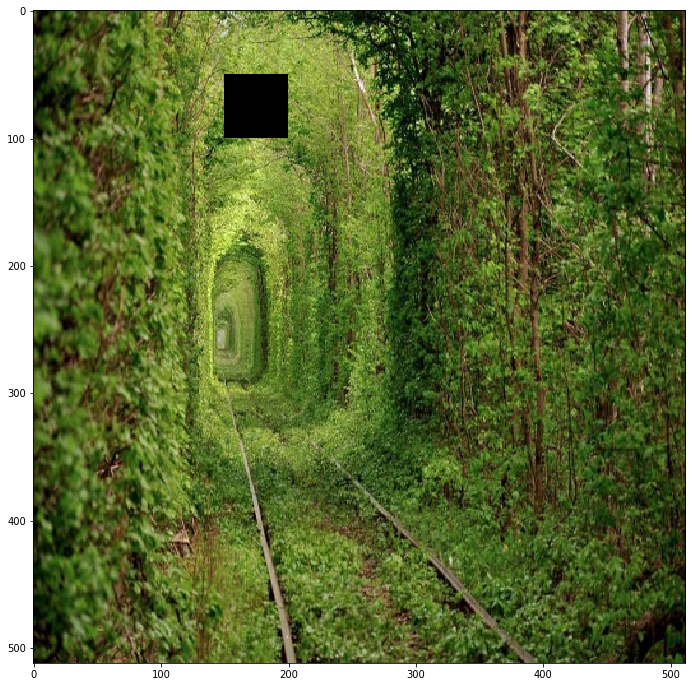

In [30]:
mask_to_fill = np.zeros_like(img[:,:,0])
mask_to_fill[50:100,150:200] = 1.0
# For convenience we will stack the hole to get 3-channeled image
mask_to_fill = np.stack([mask_to_fill]*3, axis=-1)
# print('shape is', mask_to_fill.shape)
# TODO: kN = 50???
crop_mask = cv2.dilate(mask_to_fill, np.ones((30,30))) # This is the neighborhood of the hole

# visualize the image with hole
img_with_hole = img.copy()
img_with_hole[mask_to_fill == 1] = 0

plt.figure(figsize=(12,12))
plt.imshow(img*(1.0 - mask_to_fill))

#### How to get the boundary of the hole?

In [0]:
def get_boundary(mask):
    kN = 3
    inner_part = cv2.erode(mask, np.ones((kN, kN))) # TODO obtain the boundary of a binary mask, which has a shape (H, W)
    return mask - inner_part

#### Define some parameters

In [0]:
kernel_radius = 12
kernel_size = 2*kernel_radius + 1
kernel = np.ones((kernel_size, kernel_size))

eps = 0.0

#### You can use this auxiliary function, in order to find the pixels of the hole. 

In [0]:
def get_where_indices(arr):
    arr = np.where(arr)
    return np.array([[arr[0][i], arr[1][i]] for i in range(len(arr[0]))])

#### The sum of squared differences

In [0]:
def ssd(arr1, arr2):
    return np.sum((arr1 - arr2)**2)

In [0]:
def fill_the_boundary(img, mask_to_fill, kernel_radius = 10, eps = 1e-3):
    img_ = img.copy()
    kernel_size = 2*kernel_radius + 1
    kernel = np.ones((kernel_size, kernel_size))
    
    boundary = get_boundary(mask_to_fill)
    
    # TODO obtain an image with values from {0, 1}
    # such that mask_to_get_valid[i,j,0] = 1 if and only if the pixel (i,j) is a valid pixel
    mask_to_get_valid = crop_mask -  cv2.dilate(mask_to_fill, kernel)
    
    # This tensor will help with determining the distances between patches. 
    count_tensor = convolve2d(1.0 - mask_to_fill[:,:,0], kernel, mode = 'same')
    # The element count_tensor[i,j] shows the number of known pixels in the patch \omega((i,j))
    
    masked_img = img_*(1.0-mask_to_fill)
    
    where_to_fill = get_where_indices(boundary[:,:,0])
    where_to_get = get_where_indices(mask_to_get_valid[:,:,0])
        
    for ind_fill in tqdm(where_to_fill):
        i, j = ind_fill
        # TODO get the patch centered in the pixel (i,j) and with the size (kernel_size, kernel_size)
        patch_x = int(i - kernel_size / 2)
        patch_y = int(j - kernel_size / 2)
        patch_to_replace = img_[patch_x : patch_x + kernel_size, patch_y : patch_y + kernel_size]
        
        # TODO get the mask such that patch_mask[u,v] = 1 if and only if the pixel (u,v) is known in the patch patch_to_replace
        patch_mask = 1.0 - mask_to_fill[patch_x : patch_x + kernel_size, patch_y : patch_y + kernel_size, 0]
        
        scores = []
        for idx_get in range(where_to_get.shape[0]):
            i_get, j_get = where_to_get[idx_get]
            
            # TODO get the patch centered in the pixel (i_get,j_get) and with the size (kernel_size, kernel_size)
            patch_i = int(i_get - kernel_size / 2)
            patch_j = int(j_get - kernel_size / 2)
            patch_to_get = img_[patch_i : patch_i + kernel_size, patch_j : patch_j + kernel_size]
            
            # TODO compute the distance of patches patch_to_get and patch_to_replace
            scores.append(ssd(patch_to_replace * np.stack([patch_mask]*3, axis = -1), patch_to_get * np.stack([patch_mask]*3, axis = -1)))
        
        # TODO randomly chose a valid pixel (i_match, j_match) such that dist(ω((i,j)),ω((i_match, j_match))) ≤ min(scores) + ε
        scores = np.array(scores)
        scores_ = np.argwhere(scores <= min(scores) + eps).flatten()
        i_match, j_match = where_to_get[random.choice(scores_)]
        # fill the value (i.e. replace zeros) of $(i,j)$ with the value of (i_match, j_match)
        masked_img[i,j] = masked_img[i_match, j_match]
            
    # TODO update the mask_to_fill, since the boundary of the hole is already filled
    mask_to_fill = mask_to_fill - boundary
    
    return masked_img, mask_to_fill

In [0]:
import random



  0%|          | 0/196 [00:00<?, ?it/s]

  1%|          | 2/196 [00:00<00:13, 14.92it/s]

  2%|▏         | 4/196 [00:00<00:13, 14.63it/s]

  3%|▎         | 6/196 [00:00<00:13, 14.57it/s]

  4%|▍         | 8/196 [00:00<00:12, 15.21it/s]

  5%|▌         | 10/196 [00:00<00:11, 15.91it/s]

  6%|▌         | 12/196 [00:00<00:11, 15.93it/s]

  7%|▋         | 14/196 [00:00<00:11, 16.28it/s]

  8%|▊         | 16/196 [00:01<00:11, 16.04it/s]

  9%|▉         | 18/196 [00:01<00:11, 15.71it/s]

 10%|█         | 20/196 [00:01<00:11, 15.06it/s]

 11%|█         | 22/196 [00:01<00:11, 15.49it/s]

 12%|█▏        | 24/196 [00:01<00:10, 15.94it/s]

 13%|█▎        | 26/196 [00:01<00:10, 16.47it/s]

 14%|█▍        | 28/196 [00:01<00:09, 16.81it/s]

 15%|█▌        | 30/196 [00:01<00:10, 15.87it/s]

 16%|█▋        | 32/196 [00:02<00:10, 15.09it/s]

 17%|█▋        | 34/196 [00:02<00:10, 14.85it/s]

 18%|█▊        | 36/196 [00:02<00:10, 14.70it/s]

 19%|█▉        | 38/196 [00:02<00:10, 14.45it/s]

 20%|██    

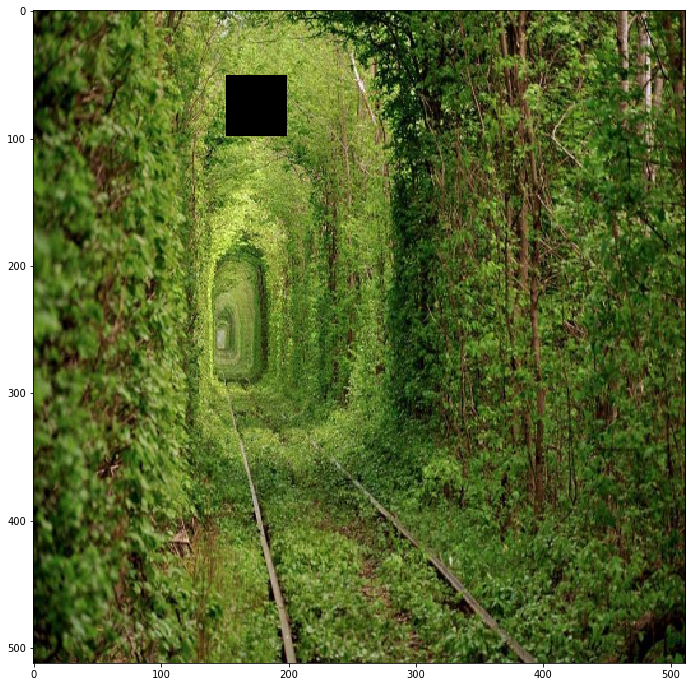



  0%|          | 0/188 [00:00<?, ?it/s]

  1%|          | 2/188 [00:00<00:14, 13.08it/s]

  2%|▏         | 4/188 [00:00<00:14, 12.99it/s]

  3%|▎         | 6/188 [00:00<00:14, 12.56it/s]

  4%|▍         | 8/188 [00:00<00:14, 12.19it/s]

  5%|▌         | 10/188 [00:00<00:14, 12.27it/s]

  6%|▋         | 12/188 [00:00<00:14, 12.31it/s]

  7%|▋         | 14/188 [00:01<00:14, 12.37it/s]

  9%|▊         | 16/188 [00:01<00:13, 12.46it/s]

 10%|▉         | 18/188 [00:01<00:13, 12.28it/s]

 11%|█         | 20/188 [00:01<00:14, 11.81it/s]

 12%|█▏        | 22/188 [00:01<00:14, 11.41it/s]

 13%|█▎        | 24/188 [00:02<00:14, 11.21it/s]

 14%|█▍        | 26/188 [00:02<00:14, 11.50it/s]

 15%|█▍        | 28/188 [00:02<00:13, 11.80it/s]

 16%|█▌        | 30/188 [00:02<00:13, 11.80it/s]

 17%|█▋        | 32/188 [00:02<00:13, 12.00it/s]

 18%|█▊        | 34/188 [00:02<00:13, 11.56it/s]

 19%|█▉        | 36/188 [00:03<00:13, 11.59it/s]

 20%|██        | 38/188 [00:03<00:13, 11.23it/s]

 21%|██▏   

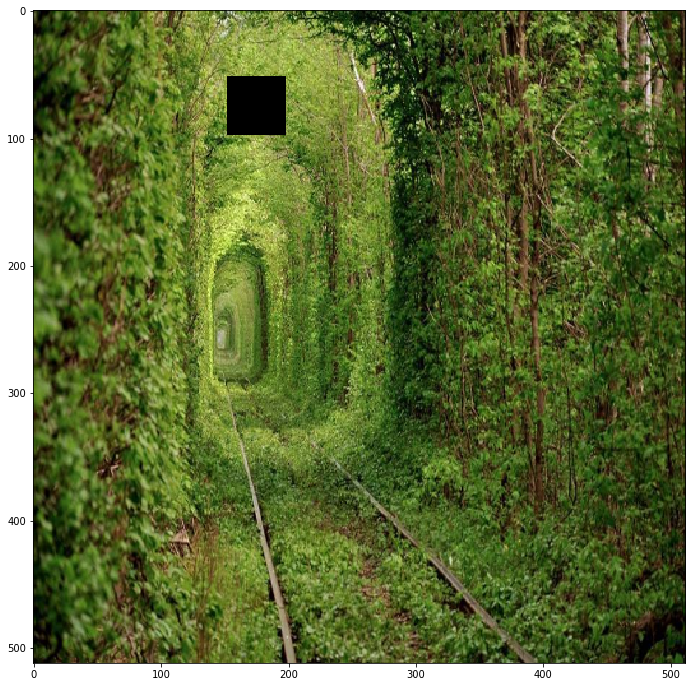



  0%|          | 0/180 [00:00<?, ?it/s]

  1%|          | 1/180 [00:00<00:21,  8.43it/s]

  1%|          | 2/180 [00:00<00:20,  8.71it/s]

  2%|▏         | 3/180 [00:00<00:19,  8.95it/s]

  2%|▏         | 4/180 [00:00<00:19,  9.17it/s]

  3%|▎         | 5/180 [00:00<00:18,  9.33it/s]

  3%|▎         | 6/180 [00:00<00:18,  9.39it/s]

  4%|▍         | 7/180 [00:00<00:18,  9.43it/s]

  4%|▍         | 8/180 [00:00<00:18,  9.50it/s]

  5%|▌         | 9/180 [00:00<00:18,  9.30it/s]

  6%|▌         | 10/180 [00:01<00:18,  9.39it/s]

  6%|▌         | 11/180 [00:01<00:17,  9.39it/s]

  7%|▋         | 12/180 [00:01<00:18,  8.94it/s]

  7%|▋         | 13/180 [00:01<00:19,  8.68it/s]

  8%|▊         | 14/180 [00:01<00:19,  8.54it/s]

  8%|▊         | 15/180 [00:01<00:19,  8.43it/s]

  9%|▉         | 16/180 [00:01<00:19,  8.45it/s]

  9%|▉         | 17/180 [00:01<00:18,  8.76it/s]

 10%|█         | 18/180 [00:02<00:19,  8.46it/s]

 11%|█         | 19/180 [00:02<00:19,  8.31it/s]

 11%|█         |

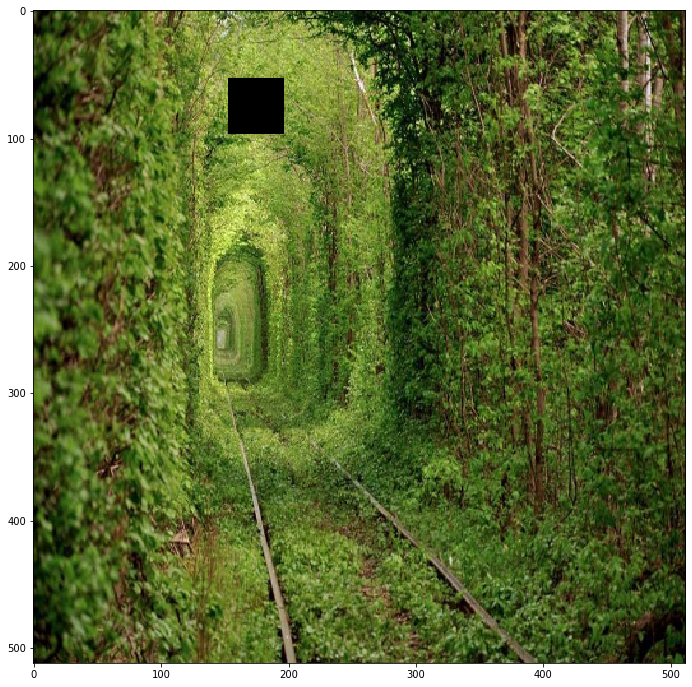



  0%|          | 0/172 [00:00<?, ?it/s]

  1%|          | 1/172 [00:00<00:25,  6.69it/s]

  1%|          | 2/172 [00:00<00:25,  6.75it/s]

  2%|▏         | 3/172 [00:00<00:25,  6.61it/s]

  2%|▏         | 4/172 [00:00<00:24,  6.84it/s]

  3%|▎         | 5/172 [00:00<00:23,  7.04it/s]

  3%|▎         | 6/172 [00:00<00:23,  7.18it/s]

  4%|▍         | 7/172 [00:00<00:22,  7.38it/s]

  5%|▍         | 8/172 [00:01<00:22,  7.25it/s]

  5%|▌         | 9/172 [00:01<00:21,  7.44it/s]

  6%|▌         | 10/172 [00:01<00:21,  7.60it/s]

  6%|▋         | 11/172 [00:01<00:21,  7.46it/s]

  7%|▋         | 12/172 [00:01<00:20,  7.69it/s]

  8%|▊         | 13/172 [00:01<00:20,  7.83it/s]

  8%|▊         | 14/172 [00:01<00:20,  7.66it/s]

  9%|▊         | 15/172 [00:02<00:20,  7.81it/s]

  9%|▉         | 16/172 [00:02<00:20,  7.73it/s]

 10%|▉         | 17/172 [00:02<00:19,  7.81it/s]

 10%|█         | 18/172 [00:02<00:19,  7.88it/s]

 11%|█         | 19/172 [00:02<00:19,  7.95it/s]

 12%|█▏        |

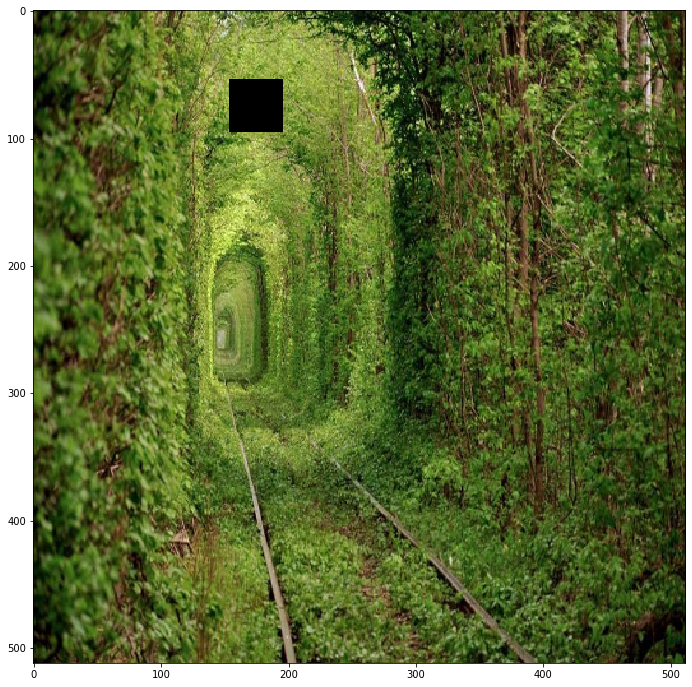



  0%|          | 0/164 [00:00<?, ?it/s]

  1%|          | 1/164 [00:00<00:26,  6.13it/s]

  1%|          | 2/164 [00:00<00:26,  6.19it/s]

  2%|▏         | 3/164 [00:00<00:25,  6.31it/s]

  2%|▏         | 4/164 [00:00<00:24,  6.53it/s]

  3%|▎         | 5/164 [00:00<00:23,  6.68it/s]

  4%|▎         | 6/164 [00:00<00:23,  6.75it/s]

  4%|▍         | 7/164 [00:01<00:22,  6.83it/s]

  5%|▍         | 8/164 [00:01<00:23,  6.66it/s]

  5%|▌         | 9/164 [00:01<00:23,  6.74it/s]

  6%|▌         | 10/164 [00:01<00:23,  6.58it/s]

  7%|▋         | 11/164 [00:01<00:23,  6.40it/s]

  7%|▋         | 12/164 [00:01<00:24,  6.25it/s]

  8%|▊         | 13/164 [00:02<00:24,  6.22it/s]

  9%|▊         | 14/164 [00:02<00:23,  6.47it/s]

  9%|▉         | 15/164 [00:02<00:22,  6.59it/s]

 10%|▉         | 16/164 [00:02<00:22,  6.48it/s]

 10%|█         | 17/164 [00:02<00:23,  6.30it/s]

 11%|█         | 18/164 [00:02<00:24,  5.93it/s]

 12%|█▏        | 19/164 [00:02<00:24,  5.96it/s]

 12%|█▏        |

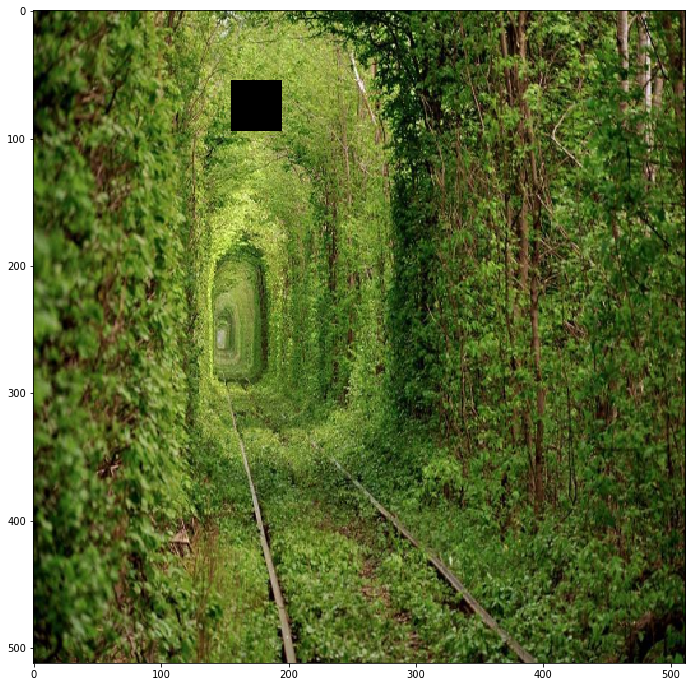



  0%|          | 0/156 [00:00<?, ?it/s]

  1%|          | 1/156 [00:00<00:24,  6.29it/s]

  1%|▏         | 2/156 [00:00<00:25,  5.95it/s]

  2%|▏         | 3/156 [00:00<00:26,  5.88it/s]

  3%|▎         | 4/156 [00:00<00:25,  6.00it/s]

  3%|▎         | 5/156 [00:00<00:25,  5.99it/s]

  4%|▍         | 6/156 [00:01<00:24,  6.07it/s]

  4%|▍         | 7/156 [00:01<00:24,  6.14it/s]

  5%|▌         | 8/156 [00:01<00:25,  5.89it/s]

  6%|▌         | 9/156 [00:01<00:25,  5.71it/s]

  6%|▋         | 10/156 [00:01<00:26,  5.57it/s]

  7%|▋         | 11/156 [00:01<00:26,  5.42it/s]

  8%|▊         | 12/156 [00:02<00:26,  5.44it/s]

  8%|▊         | 13/156 [00:02<00:25,  5.67it/s]

  9%|▉         | 14/156 [00:02<00:25,  5.54it/s]

 10%|▉         | 15/156 [00:02<00:25,  5.50it/s]

 10%|█         | 16/156 [00:02<00:26,  5.37it/s]

 11%|█         | 17/156 [00:03<00:25,  5.48it/s]

 12%|█▏        | 18/156 [00:03<00:25,  5.52it/s]

 12%|█▏        | 19/156 [00:03<00:25,  5.42it/s]

 13%|█▎        |

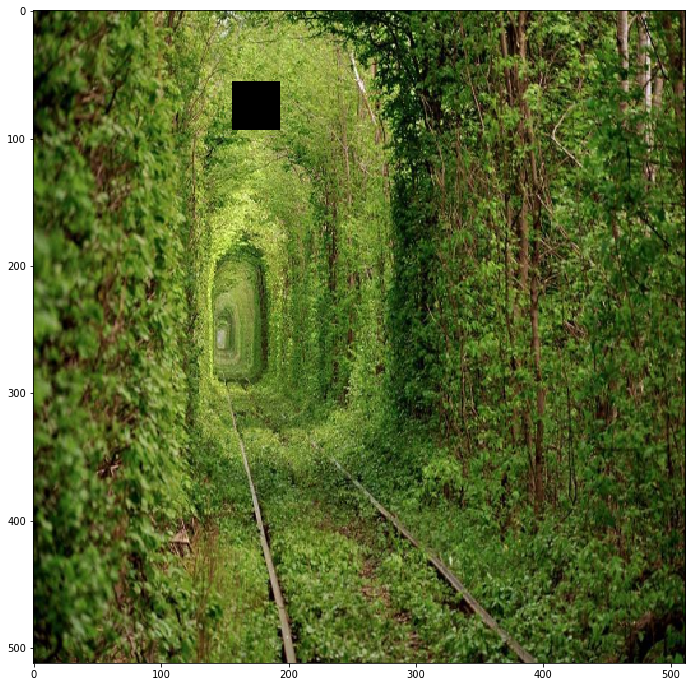



  0%|          | 0/148 [00:00<?, ?it/s]

  1%|          | 1/148 [00:00<00:24,  5.90it/s]

  1%|▏         | 2/148 [00:00<00:24,  5.86it/s]

  2%|▏         | 3/148 [00:00<00:26,  5.44it/s]

  3%|▎         | 4/148 [00:00<00:27,  5.22it/s]

  3%|▎         | 5/148 [00:00<00:28,  5.05it/s]

  4%|▍         | 6/148 [00:01<00:28,  5.06it/s]

  5%|▍         | 7/148 [00:01<00:27,  5.22it/s]

  5%|▌         | 8/148 [00:01<00:26,  5.34it/s]

  6%|▌         | 9/148 [00:01<00:25,  5.40it/s]

  7%|▋         | 10/148 [00:01<00:25,  5.46it/s]

  7%|▋         | 11/148 [00:02<00:25,  5.45it/s]

  8%|▊         | 12/148 [00:02<00:24,  5.52it/s]

  9%|▉         | 13/148 [00:02<00:24,  5.57it/s]

  9%|▉         | 14/148 [00:02<00:25,  5.35it/s]

 10%|█         | 15/148 [00:02<00:24,  5.38it/s]

 11%|█         | 16/148 [00:02<00:24,  5.45it/s]

 11%|█▏        | 17/148 [00:03<00:23,  5.46it/s]

 12%|█▏        | 18/148 [00:03<00:23,  5.52it/s]

 13%|█▎        | 19/148 [00:03<00:23,  5.59it/s]

 14%|█▎        |

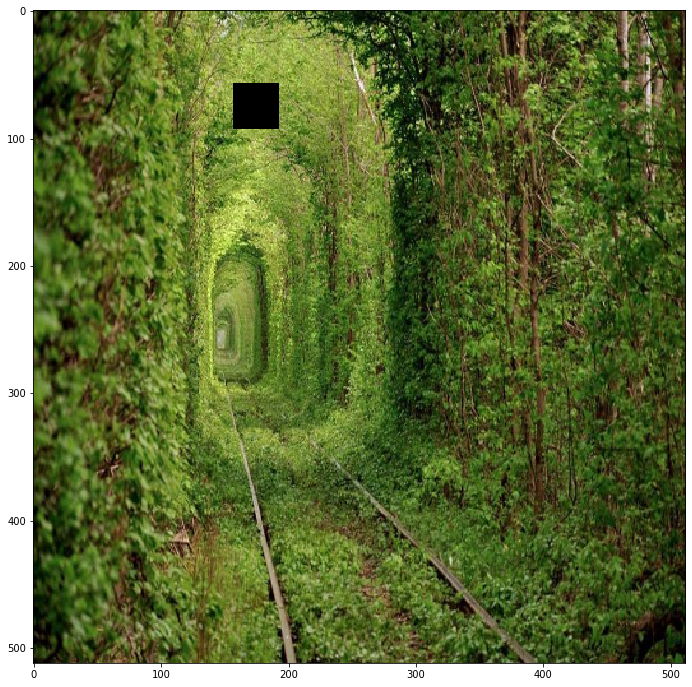



  0%|          | 0/140 [00:00<?, ?it/s]

  1%|          | 1/140 [00:00<00:27,  5.05it/s]

  1%|▏         | 2/140 [00:00<00:27,  5.07it/s]

  2%|▏         | 3/140 [00:00<00:27,  5.05it/s]

  3%|▎         | 4/140 [00:00<00:26,  5.10it/s]

  4%|▎         | 5/140 [00:00<00:26,  5.10it/s]

  4%|▍         | 6/140 [00:01<00:26,  5.04it/s]

  5%|▌         | 7/140 [00:01<00:26,  5.08it/s]

  6%|▌         | 8/140 [00:01<00:25,  5.11it/s]

  6%|▋         | 9/140 [00:01<00:26,  4.95it/s]

  7%|▋         | 10/140 [00:02<00:26,  4.83it/s]

  8%|▊         | 11/140 [00:02<00:27,  4.63it/s]

  9%|▊         | 12/140 [00:02<00:26,  4.79it/s]

  9%|▉         | 13/140 [00:02<00:25,  4.95it/s]

 10%|█         | 14/140 [00:02<00:25,  5.00it/s]

 11%|█         | 15/140 [00:03<00:24,  5.06it/s]

 11%|█▏        | 16/140 [00:03<00:24,  5.07it/s]

 12%|█▏        | 17/140 [00:03<00:24,  5.07it/s]

 13%|█▎        | 18/140 [00:03<00:23,  5.13it/s]

 14%|█▎        | 19/140 [00:03<00:23,  5.15it/s]

 14%|█▍        |

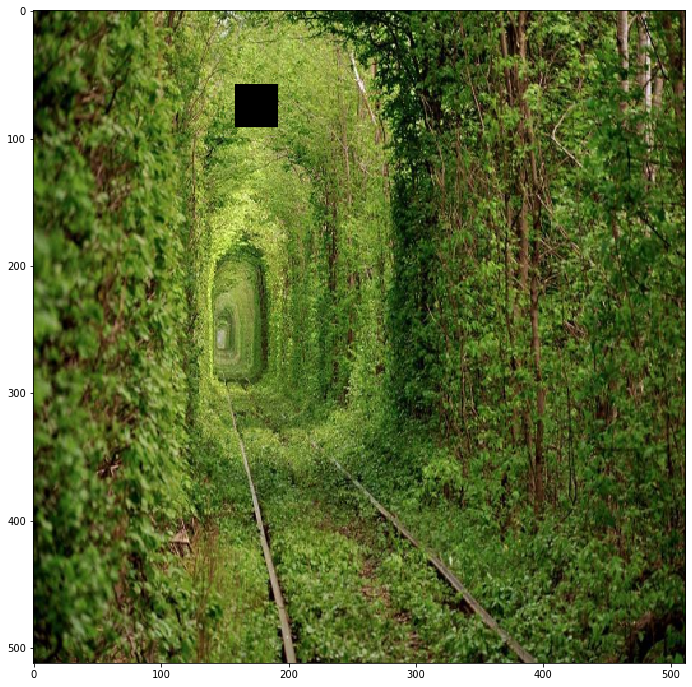



  0%|          | 0/132 [00:00<?, ?it/s]

  1%|          | 1/132 [00:00<00:26,  4.96it/s]

  2%|▏         | 2/132 [00:00<00:26,  4.89it/s]

  2%|▏         | 3/132 [00:00<00:26,  4.85it/s]

  3%|▎         | 4/132 [00:00<00:26,  4.77it/s]

  4%|▍         | 5/132 [00:01<00:26,  4.77it/s]

  5%|▍         | 6/132 [00:01<00:26,  4.75it/s]

  5%|▌         | 7/132 [00:01<00:25,  4.81it/s]

  6%|▌         | 8/132 [00:01<00:25,  4.80it/s]

  7%|▋         | 9/132 [00:01<00:25,  4.75it/s]

  8%|▊         | 10/132 [00:02<00:25,  4.77it/s]

  8%|▊         | 11/132 [00:02<00:25,  4.73it/s]

  9%|▉         | 12/132 [00:02<00:25,  4.69it/s]

 10%|▉         | 13/132 [00:02<00:26,  4.41it/s]

 11%|█         | 14/132 [00:03<00:26,  4.46it/s]

 11%|█▏        | 15/132 [00:03<00:25,  4.53it/s]

 12%|█▏        | 16/132 [00:03<00:26,  4.46it/s]

 13%|█▎        | 17/132 [00:03<00:25,  4.44it/s]

 14%|█▎        | 18/132 [00:03<00:25,  4.49it/s]

 14%|█▍        | 19/132 [00:04<00:24,  4.58it/s]

 15%|█▌        |

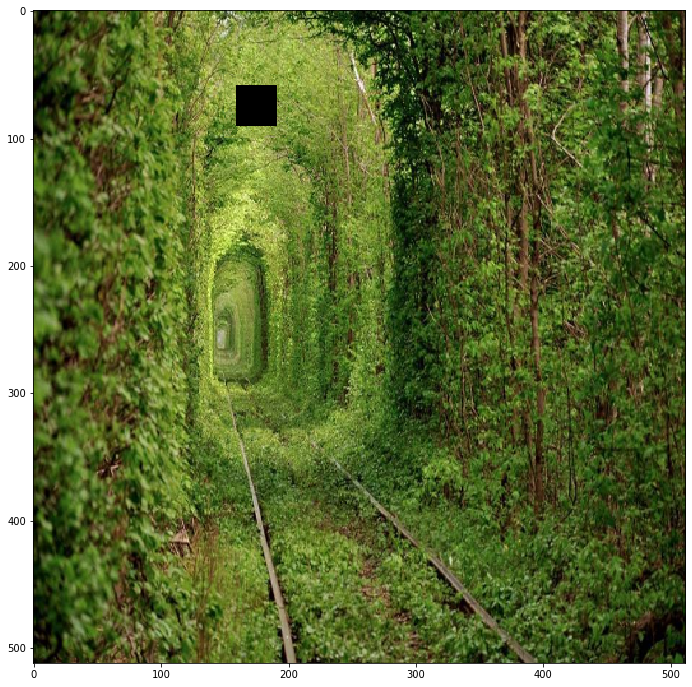



  0%|          | 0/124 [00:00<?, ?it/s]

  1%|          | 1/124 [00:00<00:27,  4.48it/s]

  2%|▏         | 2/124 [00:00<00:27,  4.45it/s]

  2%|▏         | 3/124 [00:00<00:27,  4.40it/s]

  3%|▎         | 4/124 [00:00<00:29,  4.14it/s]

  4%|▍         | 5/124 [00:01<00:29,  3.97it/s]

  5%|▍         | 6/124 [00:01<00:28,  4.07it/s]

  6%|▌         | 7/124 [00:01<00:28,  4.04it/s]

  6%|▋         | 8/124 [00:01<00:28,  4.10it/s]

  7%|▋         | 9/124 [00:02<00:27,  4.18it/s]

  8%|▊         | 10/124 [00:02<00:26,  4.24it/s]

  9%|▉         | 11/124 [00:02<00:26,  4.21it/s]

 10%|▉         | 12/124 [00:02<00:27,  4.02it/s]

 10%|█         | 13/124 [00:03<00:27,  4.07it/s]

 11%|█▏        | 14/124 [00:03<00:26,  4.19it/s]

 12%|█▏        | 15/124 [00:03<00:26,  4.15it/s]

 13%|█▎        | 16/124 [00:03<00:26,  4.09it/s]

 14%|█▎        | 17/124 [00:04<00:25,  4.15it/s]

 15%|█▍        | 18/124 [00:04<00:25,  4.21it/s]

 15%|█▌        | 19/124 [00:04<00:24,  4.25it/s]

 16%|█▌        |

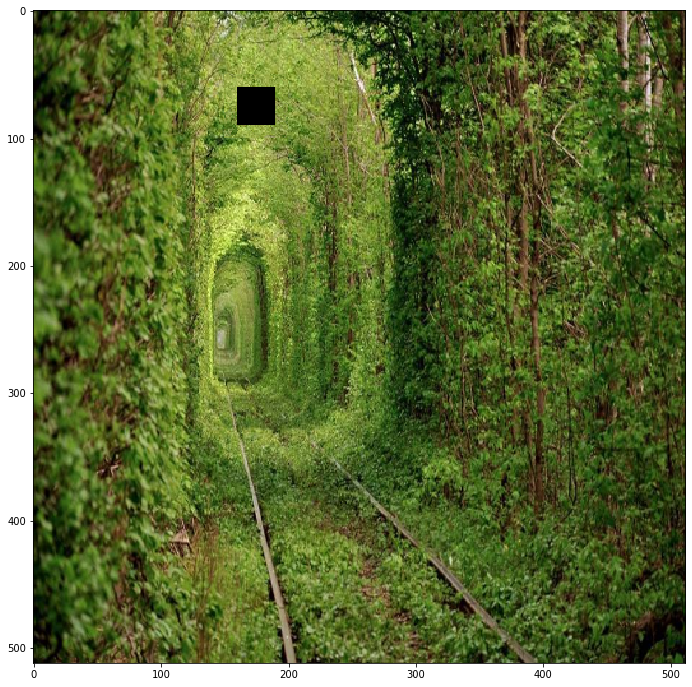



  0%|          | 0/116 [00:00<?, ?it/s]

  1%|          | 1/116 [00:00<00:26,  4.40it/s]

  2%|▏         | 2/116 [00:00<00:26,  4.27it/s]

  3%|▎         | 3/116 [00:00<00:26,  4.22it/s]

  3%|▎         | 4/116 [00:00<00:26,  4.22it/s]

  4%|▍         | 5/116 [00:01<00:27,  4.07it/s]

  5%|▌         | 6/116 [00:01<00:27,  3.96it/s]

  6%|▌         | 7/116 [00:01<00:28,  3.86it/s]

  7%|▋         | 8/116 [00:02<00:28,  3.83it/s]

  8%|▊         | 9/116 [00:02<00:27,  3.89it/s]

  9%|▊         | 10/116 [00:02<00:27,  3.89it/s]

  9%|▉         | 11/116 [00:02<00:26,  4.01it/s]

 10%|█         | 12/116 [00:03<00:25,  4.10it/s]

 11%|█         | 13/116 [00:03<00:25,  4.01it/s]

 12%|█▏        | 14/116 [00:03<00:25,  4.03it/s]

 13%|█▎        | 15/116 [00:03<00:24,  4.13it/s]

 14%|█▍        | 16/116 [00:03<00:24,  4.03it/s]

 15%|█▍        | 17/116 [00:04<00:24,  4.03it/s]

 16%|█▌        | 18/116 [00:04<00:25,  3.87it/s]

 16%|█▋        | 19/116 [00:04<00:24,  3.94it/s]

 17%|█▋        |

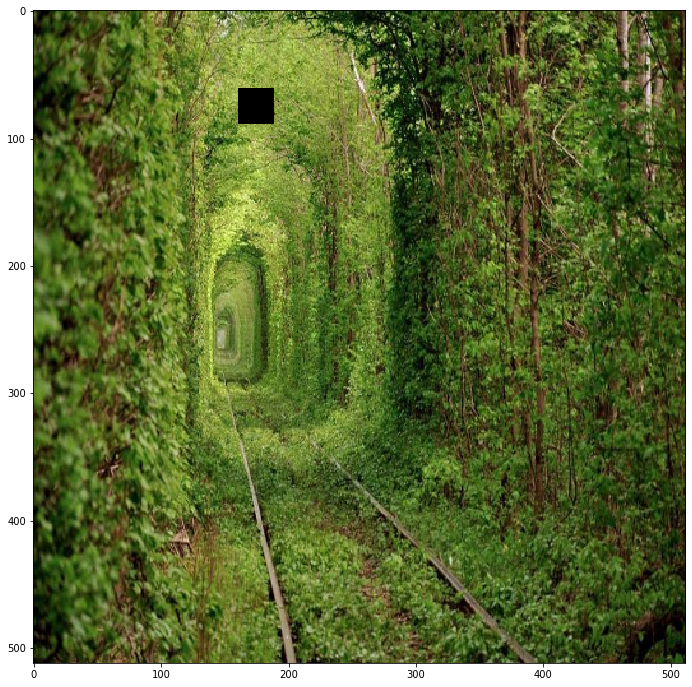



  0%|          | 0/108 [00:00<?, ?it/s]

  1%|          | 1/108 [00:00<00:27,  3.95it/s]

  2%|▏         | 2/108 [00:00<00:26,  3.96it/s]

  3%|▎         | 3/108 [00:00<00:26,  3.97it/s]

  4%|▎         | 4/108 [00:01<00:27,  3.85it/s]

  5%|▍         | 5/108 [00:01<00:27,  3.80it/s]

  6%|▌         | 6/108 [00:01<00:27,  3.66it/s]

  6%|▋         | 7/108 [00:01<00:28,  3.60it/s]

  7%|▋         | 8/108 [00:02<00:27,  3.59it/s]

  8%|▊         | 9/108 [00:02<00:26,  3.71it/s]

  9%|▉         | 10/108 [00:02<00:25,  3.79it/s]

 10%|█         | 11/108 [00:02<00:25,  3.81it/s]

 11%|█         | 12/108 [00:03<00:25,  3.75it/s]

 12%|█▏        | 13/108 [00:03<00:24,  3.83it/s]

 13%|█▎        | 14/108 [00:03<00:24,  3.85it/s]

 14%|█▍        | 15/108 [00:03<00:24,  3.83it/s]

 15%|█▍        | 16/108 [00:04<00:24,  3.73it/s]

 16%|█▌        | 17/108 [00:04<00:24,  3.77it/s]

 17%|█▋        | 18/108 [00:04<00:24,  3.73it/s]

 18%|█▊        | 19/108 [00:05<00:23,  3.77it/s]

 19%|█▊        |

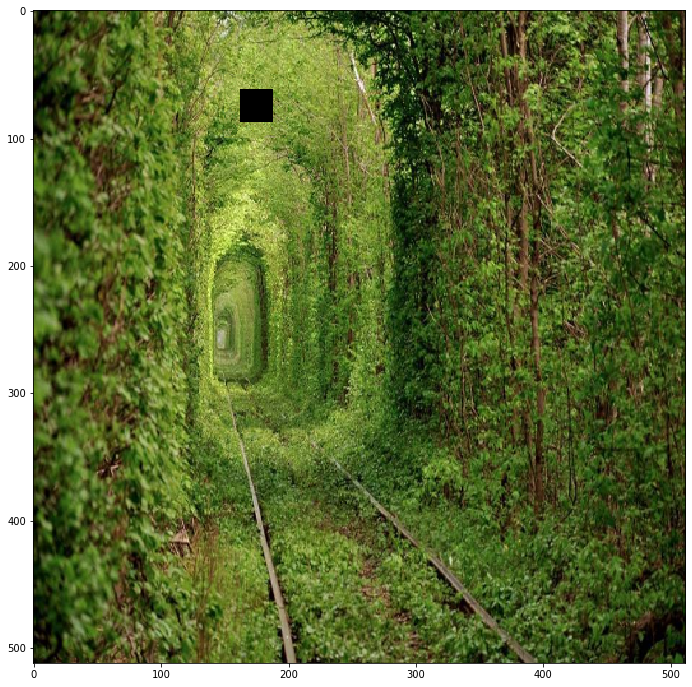



  0%|          | 0/100 [00:00<?, ?it/s]

  1%|          | 1/100 [00:00<00:27,  3.61it/s]

  2%|▏         | 2/100 [00:00<00:28,  3.48it/s]

  3%|▎         | 3/100 [00:00<00:28,  3.38it/s]

  4%|▍         | 4/100 [00:01<00:28,  3.31it/s]

  5%|▌         | 5/100 [00:01<00:28,  3.39it/s]

  6%|▌         | 6/100 [00:01<00:26,  3.49it/s]

  7%|▋         | 7/100 [00:02<00:25,  3.58it/s]

  8%|▊         | 8/100 [00:02<00:25,  3.56it/s]

  9%|▉         | 9/100 [00:02<00:25,  3.55it/s]

 10%|█         | 10/100 [00:02<00:24,  3.62it/s]

 11%|█         | 11/100 [00:03<00:24,  3.67it/s]

 12%|█▏        | 12/100 [00:03<00:24,  3.64it/s]

 13%|█▎        | 13/100 [00:03<00:23,  3.65it/s]

 14%|█▍        | 14/100 [00:03<00:23,  3.62it/s]

 15%|█▌        | 15/100 [00:04<00:23,  3.61it/s]

 16%|█▌        | 16/100 [00:04<00:23,  3.58it/s]

 17%|█▋        | 17/100 [00:04<00:23,  3.60it/s]

 18%|█▊        | 18/100 [00:05<00:22,  3.63it/s]

 19%|█▉        | 19/100 [00:05<00:22,  3.63it/s]

 20%|██        |

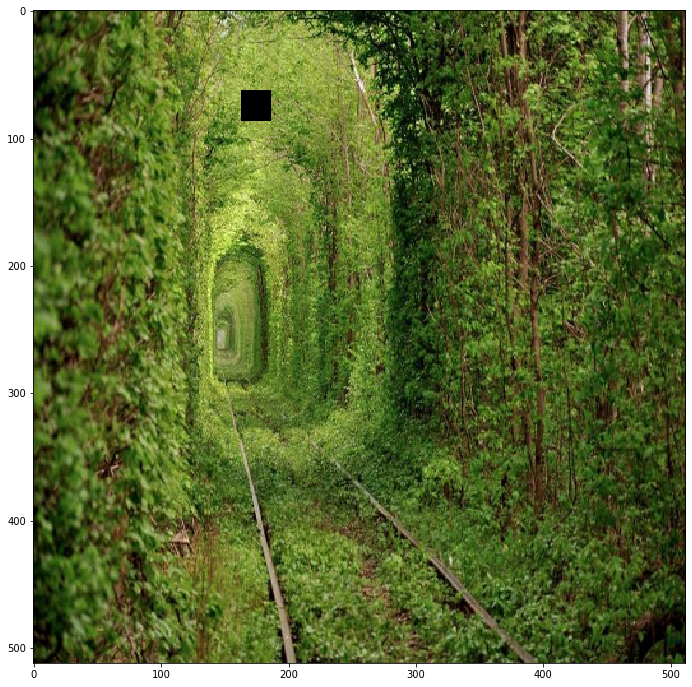



  0%|          | 0/92 [00:00<?, ?it/s]

  1%|          | 1/92 [00:00<00:25,  3.56it/s]

  2%|▏         | 2/92 [00:00<00:25,  3.49it/s]

  3%|▎         | 3/92 [00:00<00:26,  3.37it/s]

  4%|▍         | 4/92 [00:01<00:25,  3.39it/s]

  5%|▌         | 5/92 [00:01<00:25,  3.45it/s]

  7%|▋         | 6/92 [00:01<00:24,  3.51it/s]

  8%|▊         | 7/92 [00:02<00:24,  3.51it/s]

  9%|▊         | 8/92 [00:02<00:25,  3.34it/s]

 10%|▉         | 9/92 [00:02<00:25,  3.24it/s]

 11%|█         | 10/92 [00:03<00:25,  3.25it/s]

 12%|█▏        | 11/92 [00:03<00:25,  3.15it/s]

 13%|█▎        | 12/92 [00:03<00:25,  3.11it/s]

 14%|█▍        | 13/92 [00:04<00:25,  3.07it/s]

 15%|█▌        | 14/92 [00:04<00:24,  3.13it/s]

 16%|█▋        | 15/92 [00:04<00:23,  3.26it/s]

 17%|█▋        | 16/92 [00:04<00:22,  3.33it/s]

 18%|█▊        | 17/92 [00:05<00:22,  3.33it/s]

 20%|█▉        | 18/92 [00:05<00:22,  3.29it/s]

 21%|██        | 19/92 [00:05<00:21,  3.34it/s]

 22%|██▏       | 20/92 [00:06<00:21,

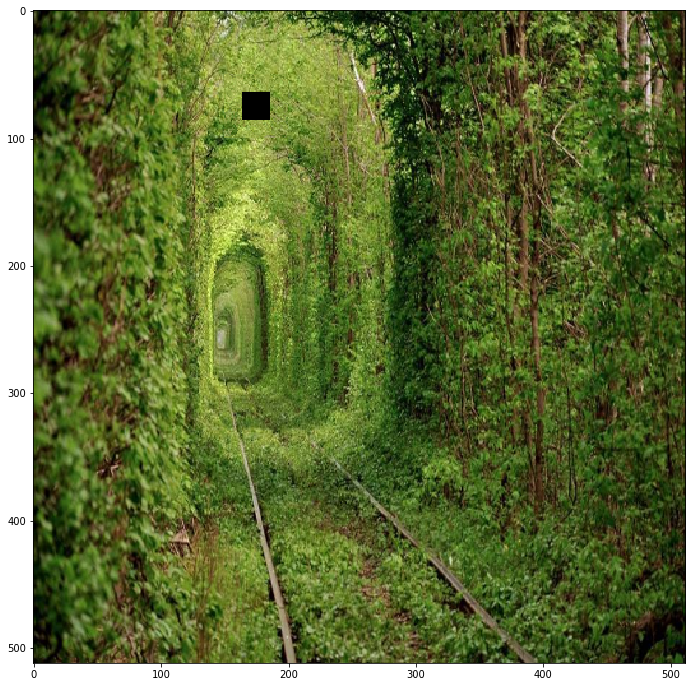



  0%|          | 0/84 [00:00<?, ?it/s]

  1%|          | 1/84 [00:00<00:24,  3.40it/s]

  2%|▏         | 2/84 [00:00<00:25,  3.26it/s]

  4%|▎         | 3/84 [00:00<00:25,  3.15it/s]

  5%|▍         | 4/84 [00:01<00:25,  3.08it/s]

  6%|▌         | 5/84 [00:01<00:25,  3.07it/s]

  7%|▋         | 6/84 [00:01<00:24,  3.14it/s]

  8%|▊         | 7/84 [00:02<00:23,  3.23it/s]

 10%|▉         | 8/84 [00:02<00:23,  3.20it/s]

 11%|█         | 9/84 [00:02<00:23,  3.17it/s]

 12%|█▏        | 10/84 [00:03<00:22,  3.26it/s]

 13%|█▎        | 11/84 [00:03<00:22,  3.20it/s]

 14%|█▍        | 12/84 [00:03<00:22,  3.21it/s]

 15%|█▌        | 13/84 [00:04<00:21,  3.28it/s]

 17%|█▋        | 14/84 [00:04<00:21,  3.32it/s]

 18%|█▊        | 15/84 [00:04<00:21,  3.22it/s]

 19%|█▉        | 16/84 [00:05<00:20,  3.29it/s]

 20%|██        | 17/84 [00:05<00:20,  3.22it/s]

 21%|██▏       | 18/84 [00:05<00:21,  3.09it/s]

 23%|██▎       | 19/84 [00:06<00:21,  3.00it/s]

 24%|██▍       | 20/84 [00:06<00:21,

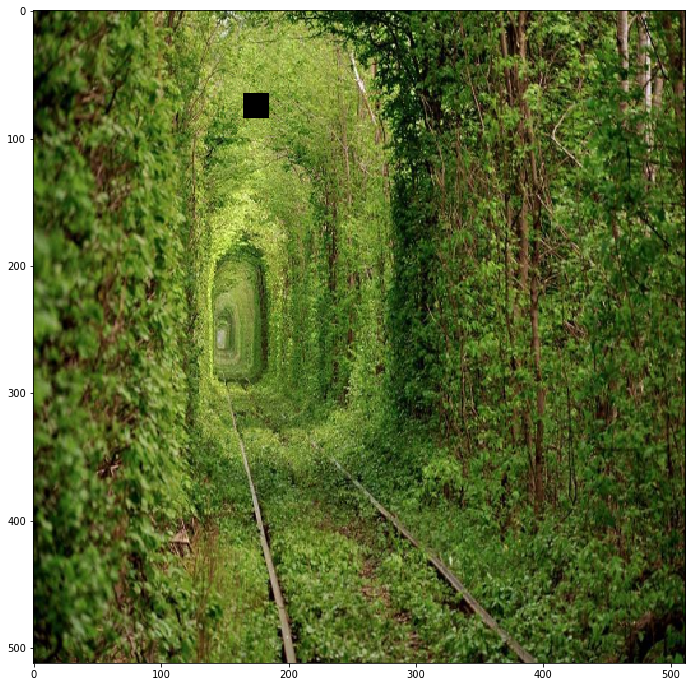



  0%|          | 0/76 [00:00<?, ?it/s]

  1%|▏         | 1/76 [00:00<00:22,  3.34it/s]

  3%|▎         | 2/76 [00:00<00:22,  3.33it/s]

  4%|▍         | 3/76 [00:00<00:21,  3.33it/s]

  5%|▌         | 4/76 [00:01<00:21,  3.32it/s]

  7%|▋         | 5/76 [00:01<00:21,  3.30it/s]

  8%|▊         | 6/76 [00:01<00:21,  3.26it/s]

  9%|▉         | 7/76 [00:02<00:21,  3.26it/s]

 11%|█         | 8/76 [00:02<00:21,  3.13it/s]

 12%|█▏        | 9/76 [00:02<00:21,  3.15it/s]

 13%|█▎        | 10/76 [00:03<00:20,  3.21it/s]

 14%|█▍        | 11/76 [00:03<00:20,  3.18it/s]

 16%|█▌        | 12/76 [00:03<00:20,  3.16it/s]

 17%|█▋        | 13/76 [00:04<00:19,  3.21it/s]

 18%|█▊        | 14/76 [00:04<00:19,  3.25it/s]

 20%|█▉        | 15/76 [00:04<00:19,  3.18it/s]

 21%|██        | 16/76 [00:04<00:18,  3.22it/s]

 22%|██▏       | 17/76 [00:05<00:18,  3.25it/s]

 24%|██▎       | 18/76 [00:05<00:18,  3.12it/s]

 25%|██▌       | 19/76 [00:05<00:19,  3.00it/s]

 26%|██▋       | 20/76 [00:06<00:18,

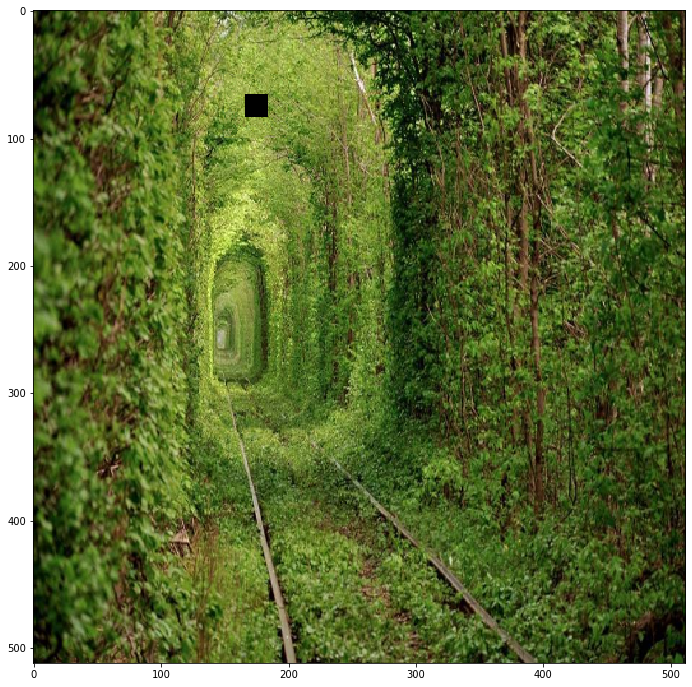



  0%|          | 0/68 [00:00<?, ?it/s]

  1%|▏         | 1/68 [00:00<00:20,  3.29it/s]

  3%|▎         | 2/68 [00:00<00:20,  3.20it/s]

  4%|▍         | 3/68 [00:01<00:22,  2.95it/s]

  6%|▌         | 4/68 [00:01<00:21,  3.02it/s]

  7%|▋         | 5/68 [00:01<00:20,  3.06it/s]

  9%|▉         | 6/68 [00:02<00:20,  2.96it/s]

 10%|█         | 7/68 [00:02<00:20,  2.93it/s]

 12%|█▏        | 8/68 [00:02<00:21,  2.83it/s]

 13%|█▎        | 9/68 [00:03<00:20,  2.83it/s]

 15%|█▍        | 10/68 [00:03<00:20,  2.89it/s]

 16%|█▌        | 11/68 [00:03<00:19,  2.96it/s]

 18%|█▊        | 12/68 [00:04<00:18,  3.03it/s]

 19%|█▉        | 13/68 [00:04<00:18,  3.04it/s]

 21%|██        | 14/68 [00:04<00:17,  3.04it/s]

 22%|██▏       | 15/68 [00:05<00:18,  2.93it/s]

 24%|██▎       | 16/68 [00:05<00:17,  2.98it/s]

 25%|██▌       | 17/68 [00:05<00:16,  3.01it/s]

 26%|██▋       | 18/68 [00:06<00:16,  3.05it/s]

 28%|██▊       | 19/68 [00:06<00:15,  3.10it/s]

 29%|██▉       | 20/68 [00:06<00:16,

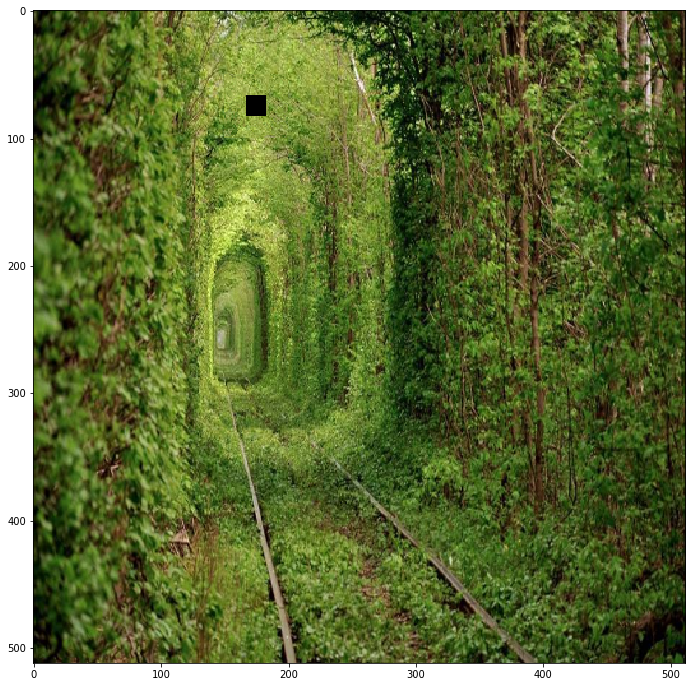



  0%|          | 0/60 [00:00<?, ?it/s]

  2%|▏         | 1/60 [00:00<00:20,  2.86it/s]

  3%|▎         | 2/60 [00:00<00:19,  2.91it/s]

  5%|▌         | 3/60 [00:01<00:19,  2.95it/s]

  7%|▋         | 4/60 [00:01<00:19,  2.93it/s]

  8%|▊         | 5/60 [00:01<00:18,  2.95it/s]

 10%|█         | 6/60 [00:02<00:18,  2.97it/s]

 12%|█▏        | 7/60 [00:02<00:17,  2.95it/s]

 13%|█▎        | 8/60 [00:02<00:18,  2.81it/s]

 15%|█▌        | 9/60 [00:03<00:17,  2.86it/s]

 17%|█▋        | 10/60 [00:03<00:17,  2.92it/s]

 18%|█▊        | 11/60 [00:03<00:17,  2.80it/s]

 20%|██        | 12/60 [00:04<00:17,  2.75it/s]

 22%|██▏       | 13/60 [00:04<00:17,  2.76it/s]

 23%|██▎       | 14/60 [00:04<00:16,  2.71it/s]

 25%|██▌       | 15/60 [00:05<00:16,  2.79it/s]

 27%|██▋       | 16/60 [00:05<00:15,  2.86it/s]

 28%|██▊       | 17/60 [00:05<00:14,  2.87it/s]

 30%|███       | 18/60 [00:06<00:14,  2.84it/s]

 32%|███▏      | 19/60 [00:06<00:14,  2.78it/s]

 33%|███▎      | 20/60 [00:07<00:14,

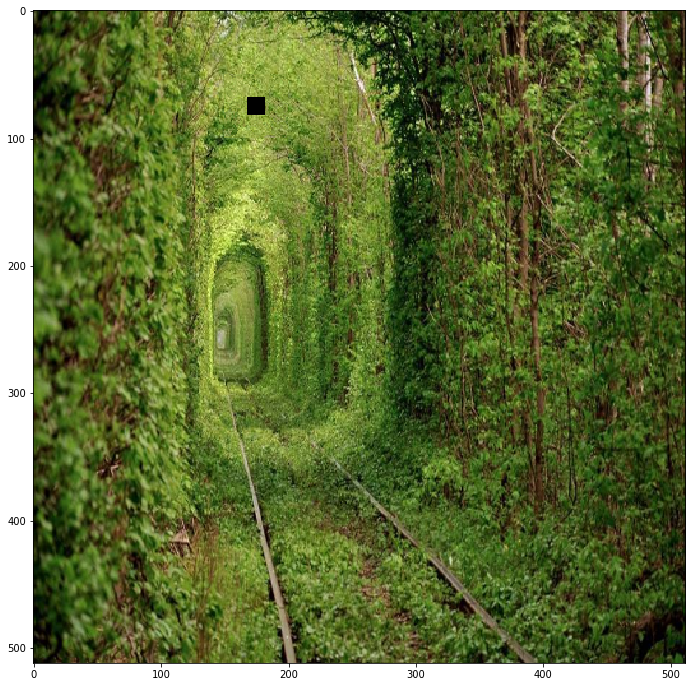



  0%|          | 0/52 [00:00<?, ?it/s]

  2%|▏         | 1/52 [00:00<00:17,  2.91it/s]

  4%|▍         | 2/52 [00:00<00:17,  2.79it/s]

  6%|▌         | 3/52 [00:01<00:17,  2.83it/s]

  8%|▊         | 4/52 [00:01<00:16,  2.86it/s]

 10%|▉         | 5/52 [00:01<00:16,  2.86it/s]

 12%|█▏        | 6/52 [00:02<00:15,  2.89it/s]

 13%|█▎        | 7/52 [00:02<00:15,  2.94it/s]

 15%|█▌        | 8/52 [00:02<00:14,  2.95it/s]

 17%|█▋        | 9/52 [00:03<00:14,  2.89it/s]

 19%|█▉        | 10/52 [00:03<00:14,  2.87it/s]

 21%|██        | 11/52 [00:03<00:14,  2.92it/s]

 23%|██▎       | 12/52 [00:04<00:13,  2.90it/s]

 25%|██▌       | 13/52 [00:04<00:13,  2.91it/s]

 27%|██▋       | 14/52 [00:04<00:13,  2.82it/s]

 29%|██▉       | 15/52 [00:05<00:13,  2.73it/s]

 31%|███       | 16/52 [00:05<00:12,  2.77it/s]

 33%|███▎      | 17/52 [00:05<00:12,  2.82it/s]

 35%|███▍      | 18/52 [00:06<00:11,  2.87it/s]

 37%|███▋      | 19/52 [00:06<00:11,  2.92it/s]

 38%|███▊      | 20/52 [00:06<00:10,

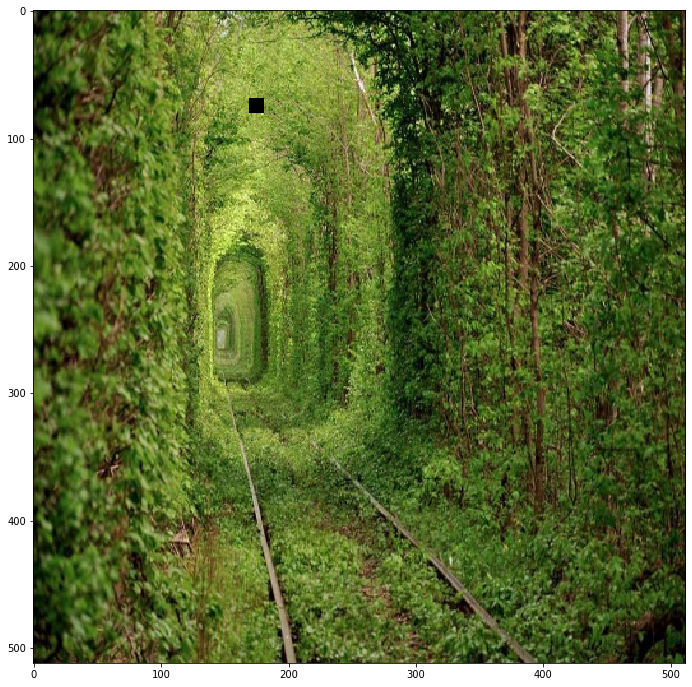



  0%|          | 0/44 [00:00<?, ?it/s]

  2%|▏         | 1/44 [00:00<00:14,  3.01it/s]

  5%|▍         | 2/44 [00:00<00:14,  2.85it/s]

  7%|▋         | 3/44 [00:01<00:15,  2.70it/s]

  9%|▉         | 4/44 [00:01<00:15,  2.66it/s]

 11%|█▏        | 5/44 [00:01<00:15,  2.59it/s]

 14%|█▎        | 6/44 [00:02<00:15,  2.53it/s]

 16%|█▌        | 7/44 [00:02<00:14,  2.50it/s]

 18%|█▊        | 8/44 [00:03<00:14,  2.47it/s]

 20%|██        | 9/44 [00:03<00:13,  2.51it/s]

 23%|██▎       | 10/44 [00:03<00:13,  2.61it/s]

 25%|██▌       | 11/44 [00:04<00:12,  2.67it/s]

 27%|██▋       | 12/44 [00:04<00:11,  2.72it/s]

 30%|██▉       | 13/44 [00:04<00:11,  2.76it/s]

 32%|███▏      | 14/44 [00:05<00:11,  2.69it/s]

 34%|███▍      | 15/44 [00:05<00:10,  2.73it/s]

 36%|███▋      | 16/44 [00:06<00:10,  2.72it/s]

 39%|███▊      | 17/44 [00:06<00:10,  2.67it/s]

 41%|████      | 18/44 [00:06<00:10,  2.58it/s]

 43%|████▎     | 19/44 [00:07<00:09,  2.50it/s]

 45%|████▌     | 20/44 [00:07<00:09,

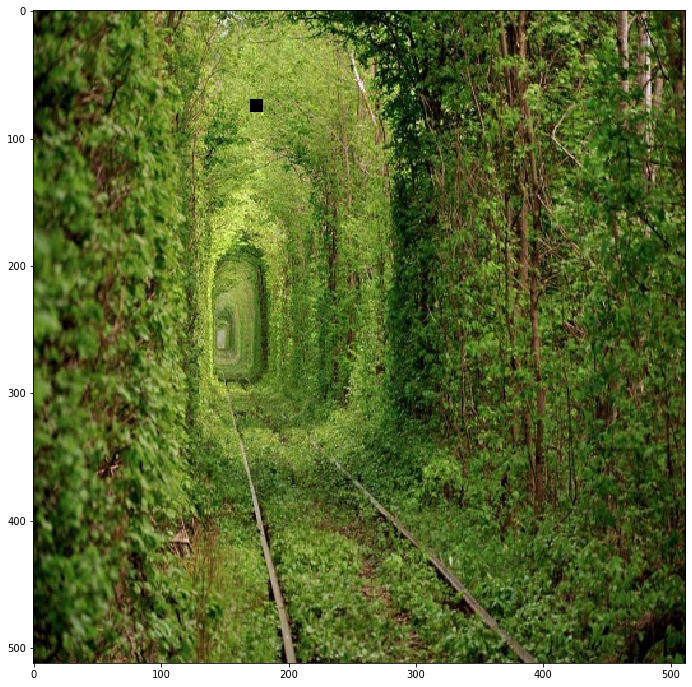



  0%|          | 0/36 [00:00<?, ?it/s]

  3%|▎         | 1/36 [00:00<00:14,  2.43it/s]

  6%|▌         | 2/36 [00:00<00:13,  2.51it/s]

  8%|▊         | 3/36 [00:01<00:12,  2.55it/s]

 11%|█         | 4/36 [00:01<00:12,  2.54it/s]

 14%|█▍        | 5/36 [00:01<00:11,  2.64it/s]

 17%|█▋        | 6/36 [00:02<00:11,  2.70it/s]

 19%|█▉        | 7/36 [00:02<00:10,  2.72it/s]

 22%|██▏       | 8/36 [00:02<00:10,  2.75it/s]

 25%|██▌       | 9/36 [00:03<00:09,  2.77it/s]

 28%|██▊       | 10/36 [00:03<00:09,  2.78it/s]

 31%|███       | 11/36 [00:04<00:09,  2.76it/s]

 33%|███▎      | 12/36 [00:04<00:09,  2.63it/s]

 36%|███▌      | 13/36 [00:04<00:08,  2.64it/s]

 39%|███▉      | 14/36 [00:05<00:08,  2.67it/s]

 42%|████▏     | 15/36 [00:05<00:08,  2.61it/s]

 44%|████▍     | 16/36 [00:05<00:07,  2.67it/s]

 47%|████▋     | 17/36 [00:06<00:07,  2.69it/s]

 50%|█████     | 18/36 [00:06<00:06,  2.68it/s]

 53%|█████▎    | 19/36 [00:07<00:06,  2.65it/s]

 56%|█████▌    | 20/36 [00:07<00:05,

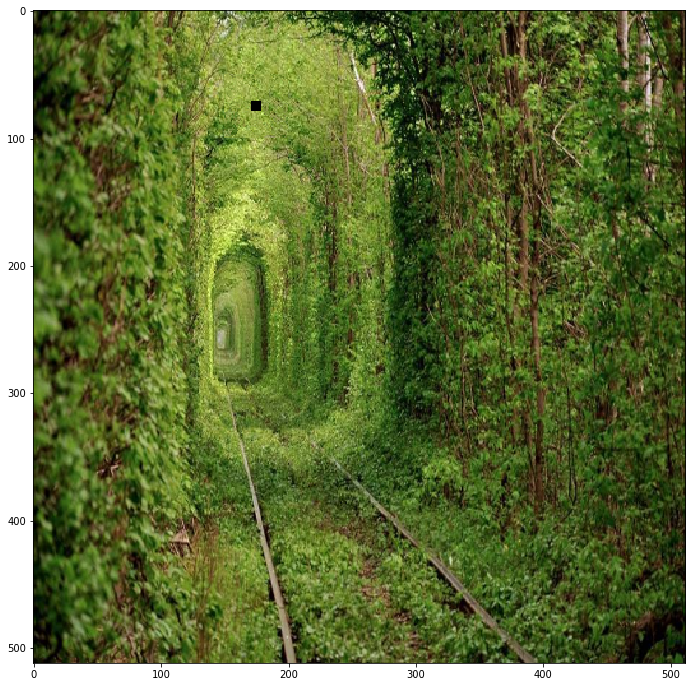



  0%|          | 0/28 [00:00<?, ?it/s]

  4%|▎         | 1/28 [00:00<00:10,  2.68it/s]

  7%|▋         | 2/28 [00:00<00:09,  2.70it/s]

 11%|█         | 3/28 [00:01<00:09,  2.60it/s]

 14%|█▍        | 4/28 [00:01<00:09,  2.51it/s]

 18%|█▊        | 5/28 [00:02<00:09,  2.44it/s]

 21%|██▏       | 6/28 [00:02<00:08,  2.53it/s]

 25%|██▌       | 7/28 [00:02<00:08,  2.59it/s]

 29%|██▊       | 8/28 [00:03<00:07,  2.61it/s]

 32%|███▏      | 9/28 [00:03<00:07,  2.65it/s]

 36%|███▌      | 10/28 [00:03<00:06,  2.64it/s]

 39%|███▉      | 11/28 [00:04<00:06,  2.59it/s]

 43%|████▎     | 12/28 [00:04<00:06,  2.57it/s]

 46%|████▋     | 13/28 [00:05<00:05,  2.58it/s]

 50%|█████     | 14/28 [00:05<00:05,  2.62it/s]

 54%|█████▎    | 15/28 [00:05<00:04,  2.61it/s]

 57%|█████▋    | 16/28 [00:06<00:04,  2.65it/s]

 61%|██████    | 17/28 [00:06<00:04,  2.54it/s]

 64%|██████▍   | 18/28 [00:06<00:03,  2.57it/s]

 68%|██████▊   | 19/28 [00:07<00:03,  2.57it/s]

 71%|███████▏  | 20/28 [00:07<00:03,

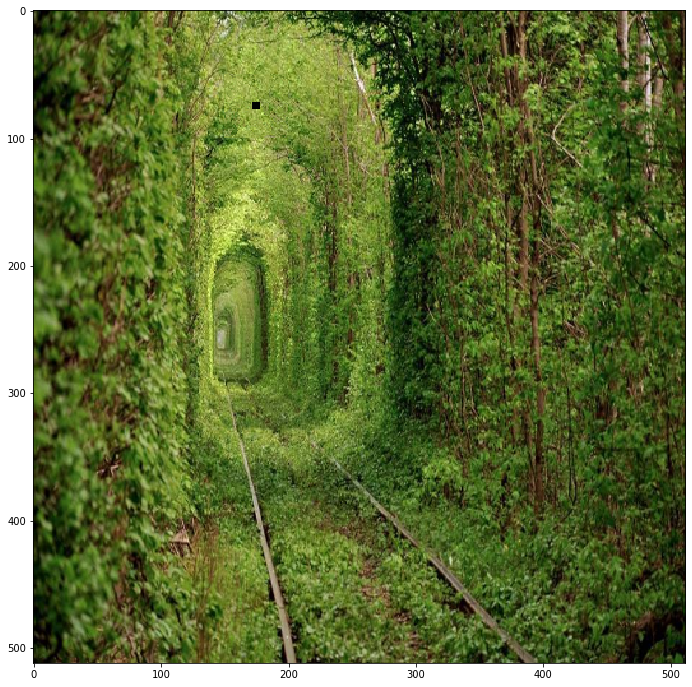



  0%|          | 0/20 [00:00<?, ?it/s]

  5%|▌         | 1/20 [00:00<00:06,  2.73it/s]

 10%|█         | 2/20 [00:00<00:06,  2.65it/s]

 15%|█▌        | 3/20 [00:01<00:06,  2.61it/s]

 20%|██        | 4/20 [00:01<00:06,  2.62it/s]

 25%|██▌       | 5/20 [00:01<00:05,  2.67it/s]

 30%|███       | 6/20 [00:02<00:05,  2.68it/s]

 35%|███▌      | 7/20 [00:02<00:04,  2.63it/s]

 40%|████      | 8/20 [00:03<00:04,  2.63it/s]

 45%|████▌     | 9/20 [00:03<00:04,  2.65it/s]

 50%|█████     | 10/20 [00:03<00:03,  2.66it/s]

 55%|█████▌    | 11/20 [00:04<00:03,  2.65it/s]

 60%|██████    | 12/20 [00:04<00:03,  2.58it/s]

 65%|██████▌   | 13/20 [00:05<00:02,  2.49it/s]

 70%|███████   | 14/20 [00:05<00:02,  2.47it/s]

 75%|███████▌  | 15/20 [00:05<00:02,  2.38it/s]

 80%|████████  | 16/20 [00:06<00:01,  2.43it/s]

 85%|████████▌ | 17/20 [00:06<00:01,  2.50it/s]

 90%|█████████ | 18/20 [00:07<00:00,  2.50it/s]

 95%|█████████▌| 19/20 [00:07<00:00,  2.54it/s]

100%|██████████| 20/20 [00:07<00:00,

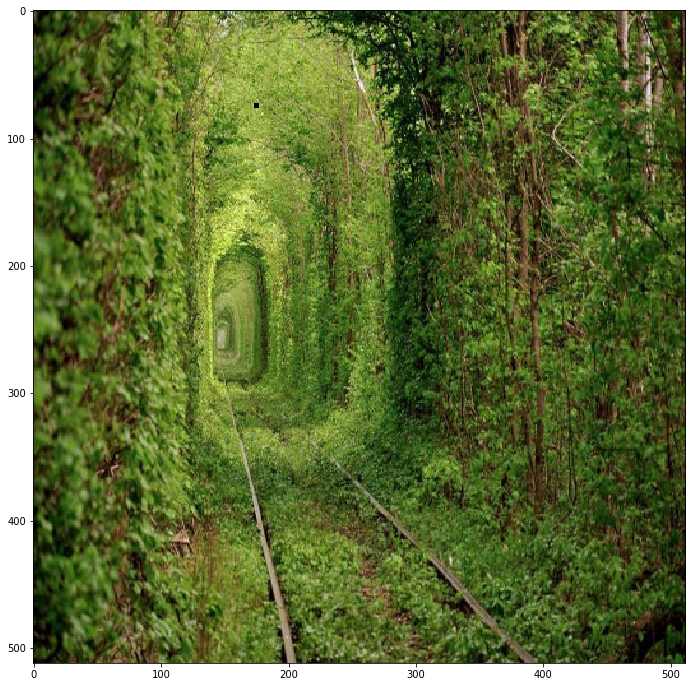



  0%|          | 0/12 [00:00<?, ?it/s]

  8%|▊         | 1/12 [00:00<00:04,  2.63it/s]

 17%|█▋        | 2/12 [00:00<00:03,  2.63it/s]

 25%|██▌       | 3/12 [00:01<00:03,  2.55it/s]

 33%|███▎      | 4/12 [00:01<00:03,  2.56it/s]

 42%|████▏     | 5/12 [00:01<00:02,  2.57it/s]

 50%|█████     | 6/12 [00:02<00:02,  2.54it/s]

 58%|█████▊    | 7/12 [00:02<00:02,  2.44it/s]

 67%|██████▋   | 8/12 [00:03<00:01,  2.47it/s]

 75%|███████▌  | 9/12 [00:03<00:01,  2.47it/s]

 83%|████████▎ | 10/12 [00:03<00:00,  2.51it/s]

 92%|█████████▏| 11/12 [00:04<00:00,  2.41it/s]

100%|██████████| 12/12 [00:04<00:00,  2.46it/s]



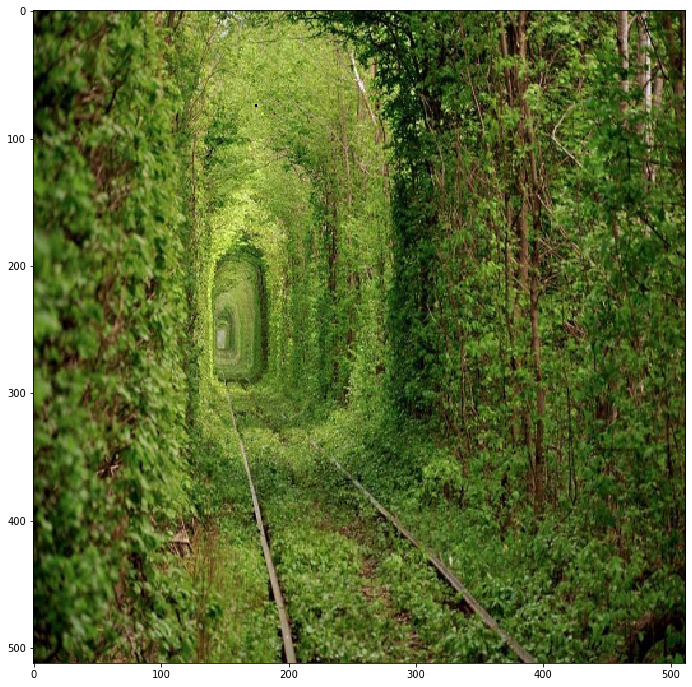



  0%|          | 0/4 [00:00<?, ?it/s]

 25%|██▌       | 1/4 [00:00<00:01,  2.36it/s]

 50%|█████     | 2/4 [00:00<00:00,  2.42it/s]

 75%|███████▌  | 3/4 [00:01<00:00,  2.38it/s]

100%|██████████| 4/4 [00:01<00:00,  2.42it/s]



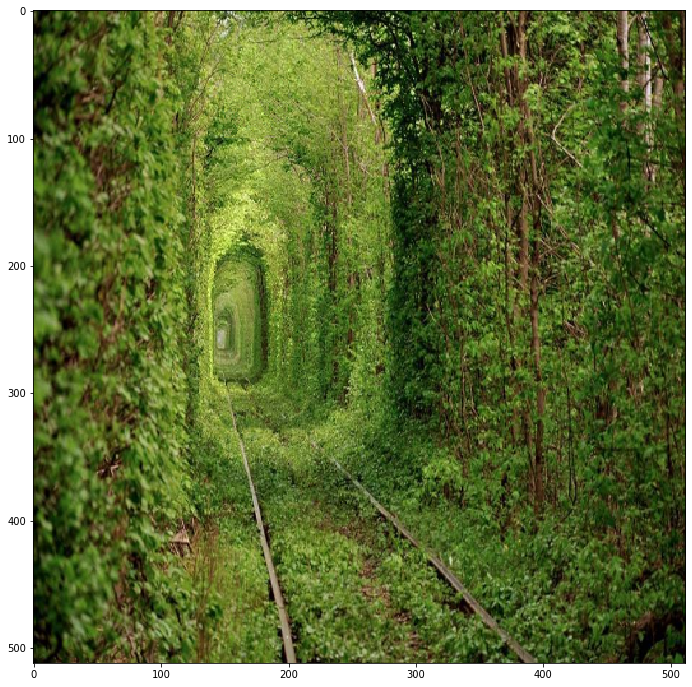

554.7890586853027


In [50]:
res = img.copy()
res_mask_to_fill = mask_to_fill.copy()
start = time()
while res_mask_to_fill[:,:,0].sum() != 0:
    res, res_mask_to_fill = fill_the_boundary(res, res_mask_to_fill, kernel_radius = kernel_radius, eps = eps)
    plt.figure(figsize = (12,12))
    plt.imshow(res)
    plt.show()
print(time()-start)

### The Supplementary Part

Modify the function $\textbf{fill_the_boundary}$ to handle with the cases when considered patches are out of the image. 

In [0]:
path_mask = [[1, 0, 1, 0]]
path_rep = [[1, 1, 0, 0]]
path_rep[path_mask == 1]
np.bitwise_and(path_mask, path_rep)

In [0]:
path_mask * path_rep